# Nonlinear MHD code in one dimension
Normalized ideal MHD equations for denstiy $\rho$, velocity $\textbf{u}$, pressure $p$ and magnetic field $\textbf{B}$:



\begin{align}
\partial_t\rho+\partial_x\left(\rho u_x\right)=0 \\
\partial_t\left(\rho\textbf{u}\right)+\left(\textbf{e}_x\cdot\partial_x\right)\cdot\left[\rho\textbf{uu}+\frac{1}{2}\left(p+B^2\right)-\textbf{BB}\right]=0 \\
\partial_t\textbf{B}=\left(\textbf{e}_x\cdot\partial_x\right)\times\left(\textbf{u}\times\textbf{B}\right) \\
\partial_t p=\partial_x\left(pu_x\right)-(\gamma-1)p\partial_x u_x
\end{align}






This script uses a Lax-Wendroff method to numerically solve the conservation law $\partial_t\textbf{U}+\partial_x\textbf{F}(\textbf{U})=0$ with $\textbf{U}=\left(\rho,\rho u_x,\rho u_y,\rho u_z,B_x,B_y,B_z,\epsilon\right)^T$. The energy density is
\begin{align}
\epsilon=\frac{1}{2}\rho u^2+\frac{p}{2(\gamma-1)}+\frac{B^2}{2}.
\end{align}

Positive advection speed:[1. 3. 5.]
Negative advection speed:[2. 4. 6.]
Choose your initial condition 1



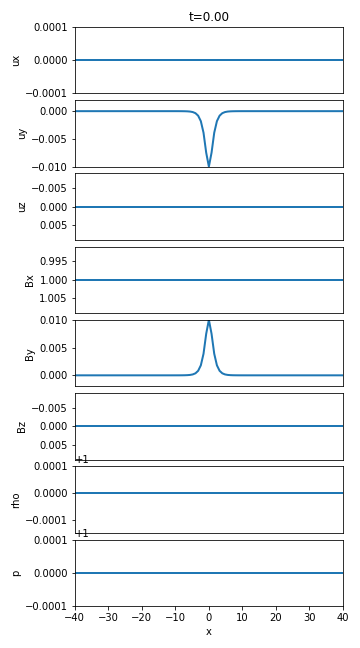
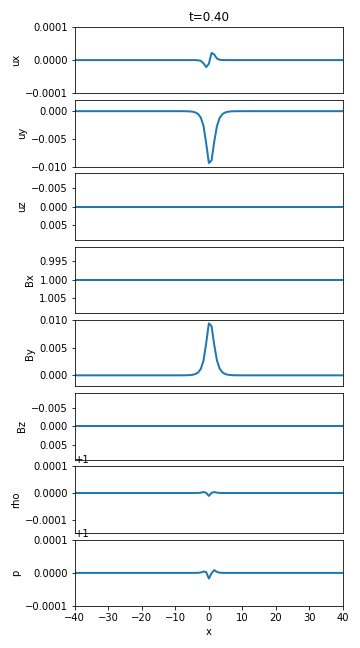
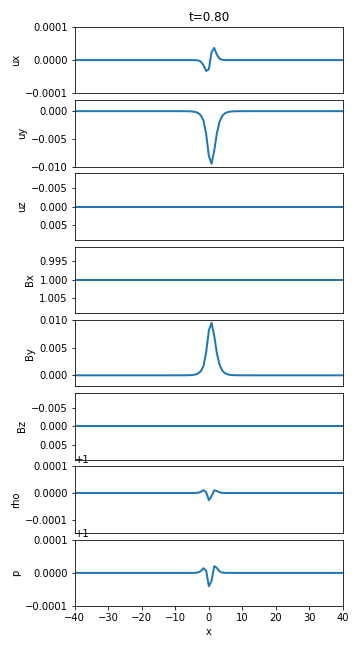
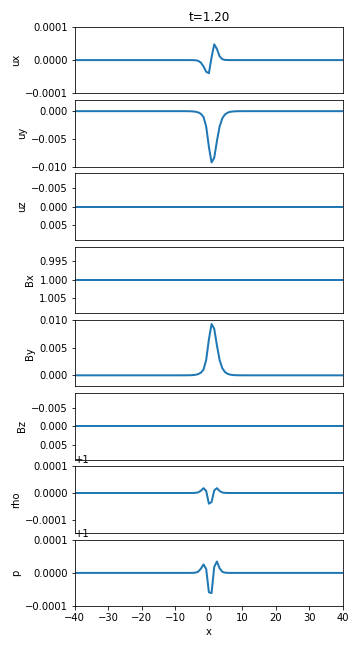
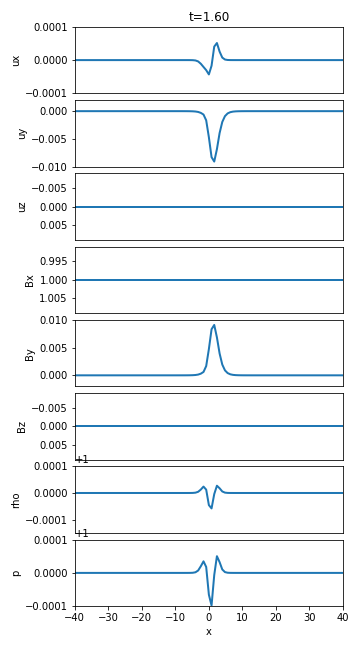
...
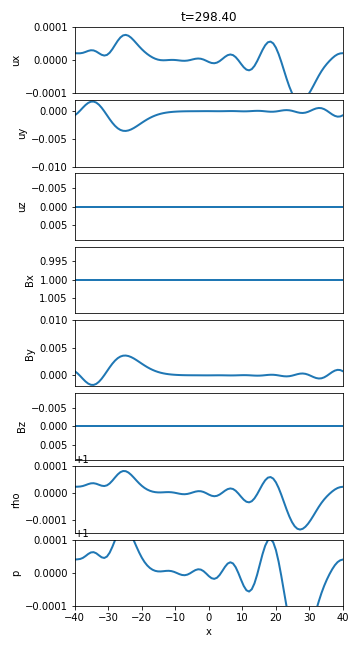
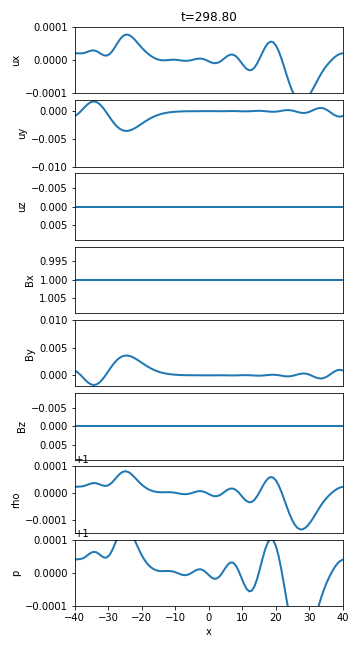
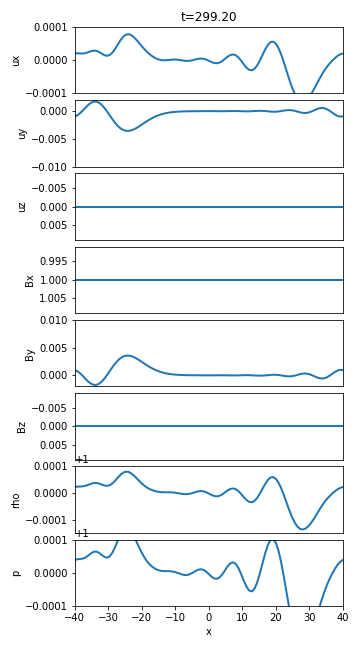
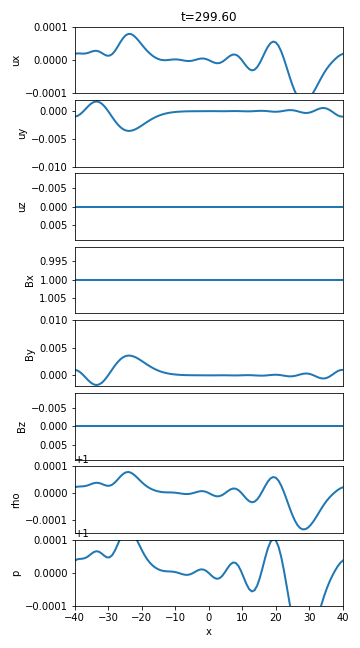
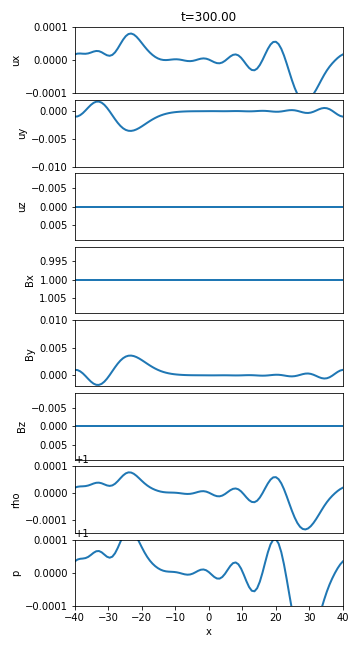

In [16]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from JSAnimation import IPython_display
from matplotlib import animation
from scipy.linalg import block_diag
from numpy.linalg import inv
from numpy import linalg as LA
from sympy import *





#Input Parameters
rho0 = 1       #Equilibrium mass density of plasma
p0 = 1         #Equilibrium pressure of plasma
B0x = 1        #Background magnetic field x
B0y = 0        #Background magnetic field y
B0z = 0        #Background magnetic field z
gamma = 5/3    #Adiabatic exponent
eta = 0        #Resistivity
nu = 0         #Viscosity
a = -0.01      #Amplitude of largest pertubation
L = 40         #Length of x-domain in + and - direction (L_tot=2L)
T = 300        #Simulation time
Nx = 100       #Number of grid cells in x-direction
CFL = 0.5      #CFL-condition
func = 2       #Shape of initial condition (1: sine shaped, 2: 1/cosh shaped)

#deltat=1





#System matrix
A0 = np.array([0,0,0,0,B0y/rho0,B0z/rho0,0,1/(2*rho0)])
A1 = np.array([0,0,0,0,-B0x/rho0,0,0,0])                
A2 = np.array([0,0,0,0,0,-B0x/rho0,0,0])                
A3 = np.array([0,0,0,0,0,0,0,0])                
A4 = np.array([B0y,-B0x,0,0,0,0,0,0])                
A5 = np.array([B0z,0,-B0x,0,0,0,0,0])                
A6 = np.array([rho0,0,0,0,0,0,0,0])                
A7 = np.array([p0*gamma,0,0,0,0,0,0,0])              
A = np.array([A0,A1,A2,A3,A4,A5,A6,A7])





#Eigenvalues (Advection speed) and eigenvectors (initial conditions)
v,w = LA.eig(A)
indicespos = np.array([])
indicesneg = np.array([])




#Sort by positve and negative advection speeds
for i in range(0,v.size):
    if v[i]>0:
        indicespos = np.append(indicespos,i)
    elif v[i]<0:
        indicesneg = np.append(indicesneg,i)
        
        
        
        
#Choice of initial condition        
print('Positive advection speed:'+str(indicespos))
print('Negative advection speed:'+str(indicesneg))
initial = int(input("Choose your initial condition ")) 




#Normalisation of inital condition
Uinit = a*w[:,initial]/np.amax(abs(w[:,initial]))
v = v[initial]




#Initial condition for Finite Differences (u1x,u1y,u1z,B1x,B1y,B1z,rho,p)
def initial_Conditions(x,func):
    if func==1:
        return np.outer(Uinit,np.sin(x*np.pi/L));
    elif func==2:
        return np.outer(Uinit,1/np.cosh(x*40/L));






#Define Flux F(U) and Jacobian J=(dF/dU)
U0,U1,U2,U3,U4,U5,U6,U7 = symbols('U0 U1 U2 U3 U4 U5 U6 U7')
    
F=Matrix([U1,\
          U1**2/U0+(gamma-1)*(U7-1/(2*U0)*(U1**2+U2**2+U3**2)-1/2*(U4**2+U5**2+U6**2))+U5**2+U6**2,\
          U1*U2/U0-U4*U5,\
          U1*U3/U0-U4*U6,\
          0,\
          U1*U5/U0-U2*U4/U0,\
          U1*U6/U0-U3*U4/U0,\
          U1**2/(2*U0**2)*(U1**2+U2**2+U3**2)+gamma*U1*U7/U0-gamma*U1/(2*U0**2)*(U1**2+U2**2+U3**2)-gamma*U1/(2*U0)*(U4**2+U5**2+U6**2)+U1*U6**2/U0-U3*U4*U6/U0-U2*U4*U5/U0+U1*U5**2/U0])
    
Flux = lambdify((U0,U1,U2,U3,U4,U5,U6,U7),F) 
S = Matrix([U0,U1,U2,U3,U4,U5,U6,U7])
J = F.jacobian(S)
Jacobian = lambdify((U0,U1,U2,U3,U4,U5,U6,U7),J)



#Evaluation of Flux F(U) and Jacobian J(U)
def FJ(U,flux,jacobian):
    F = flux(U[0],U[1],U[2],U[3],U[4],U[5],U[6],U[7])
    J = jacobian(U[0],U[1],U[2],U[3],U[4],U[5],U[6],U[7])
    return F.flatten(),J


    
    

def D(U):
    diff = np.zeros(8)
    diff[0] = nu*U[0]
    diff[1] = nu*U[1]
    diff[2] = nu*U[2]
    diff[3] = nu*U[3]
    diff[4] = eta*U[5]
    diff[5] = eta*U[5]
    diff[6] = eta*U[6]
    diff[7] = eta*(U[4]**2+U[6]**2)+nu*U[7]
    return diff




#Lax-Wendroff scheme for nonlinear MHD equations in one dimensions
def LaxWendroffNonlinear(L,T,Nx,CFL,v,eta,initialConditions,fun):
    deltax = 2*L/Nx
    deltat = deltax*CFL/np.abs(v)
    Nt = np.int(T/deltat)
    x = np.linspace(-L,L,Nx+1)
    U = np.zeros((Nt+1,Nx+1,8))
    IC = initialConditions(x,fun)
    U[0,:,0] = IC[6,:]+rho0                                                          
    U[0,:,1] = (IC[6,:]+rho0)*IC[0,:]
    U[0,:,2] = (IC[6,:]+rho0)*IC[1,:]
    U[0,:,3] = (IC[6,:]+rho0)*IC[2,:]
    U[0,:,4] = IC[3,:]+B0x
    U[0,:,5] = IC[4,:]+B0y
    U[0,:,6] = IC[5,:]+B0z
    U[0,:,7] = 1/2*(IC[6,:]+rho0)*(IC[0,:]**2+IC[1,:]**2+IC[2,:]**2)+(IC[7,:]+p0)/(2*(gamma-1))+1/2*((IC[3,:]+B0x)**2+(IC[4,:]+B0y)**2+(IC[5,:]+B0z)**2)                                     
    for n in range(0,Nt):
        for j in range(0,Nx):
            if j==0:
                U[n+1,j,:] = U[n,j,:]-deltat/(2*deltax)*(FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,-2,:],Flux,Jacobian)[0])+deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j+1,:]),Flux,Jacobian)[1],FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j,:],Flux,Jacobian)[0]))-deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,-2,:]),Flux,Jacobian)[1],FJ(U[n,j,:],Flux,Jacobian)[0]-FJ(U[n,-2,:],Flux,Jacobian)[0]))+deltat/deltax**2*(D(U[n,-2,:])-2*D(U[n,j,:])+D(U[n,j+1,:]))
                U[n+1,-1,:] = U[n+1,0,:]
            elif j==Nx-1:
                U[n+1,j,:] = U[n,j,:]-deltat/(2*deltax)*(FJ(U[n,0,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0])+deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,0,:]),Flux,Jacobian)[1],FJ(U[n,0,:],Flux,Jacobian)[0]-FJ(U[n,j,:],Flux,Jacobian)[0]))-deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j-1,:]),Flux,Jacobian)[1],FJ(U[n,j,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0]))+deltat/deltax**2*(D(U[n,j-1,:])-2*D(U[n,j,:])+D(U[n,0,:]))
                U[n+1,-1,:] = U[n+1,0,:]
            else:
                U[n+1,j,:] = U[n,j,:]-deltat/(2*deltax)*(FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0])+deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j+1,:]),Flux,Jacobian)[1],FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j,:],Flux,Jacobian)[0]))-deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j-1,:]),Flux,Jacobian)[1],FJ(U[n,j,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0]))+deltat/deltax**2*(D(U[n,j-1,:])-2*D(U[n,j,:])+D(U[n,j+1,:]))
                U[n+1,-1,:] = U[n+1,0,:]
              
    return U





#Leapfrog-Dufort-Frankel scheme for nonlinear MHD equations in one dimensions
def LeapfrogDufortFrankel(L,T,Nx,CFL,v,eta,initialConditions,fun):
    deltax = 2*L/Nx
    deltat = deltax*CFL/np.abs(v)
    alpha = 1+eta*2*deltat/deltax**2
    Nt = np.int(T/deltat)
    x = np.linspace(-L,L,Nx+1)
    U = np.zeros((Nt+1,Nx+1,8))
    IC = initialConditions(x,fun)
    U[0,:,0] = IC[6,:]+rho0                                                          
    U[0,:,1] = (IC[6,:]+rho0)*IC[0,:]
    U[0,:,2] = (IC[6,:]+rho0)*IC[1,:]
    U[0,:,3] = (IC[6,:]+rho0)*IC[2,:]
    U[0,:,4] = IC[3,:]+B0x
    U[0,:,5] = IC[4,:]+B0y
    U[0,:,6] = IC[5,:]+B0z
    U[0,:,7] = 1/2*(IC[6,:]+rho0)*(IC[0,:]**2+IC[1,:]**2+IC[2,:]**2)+(IC[7,:]+p0)/(2*(gamma-1))+1/2*((IC[3,:]+B0x)**2+(IC[4,:]+B0y)**2+(IC[5,:]+B0z)**2)                                       
    for n in range(0,Nt):
        if n==0:
            for j in range(0,Nx):
                if j==0:
                    U[n+1,j,:] = U[n,j,:]-deltat/(2*deltax)*(FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,-2,:],Flux,Jacobian)[0])+deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j+1,:]),Flux,Jacobian)[1],FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j,:],Flux,Jacobian)[0]))-deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,-2,:]),Flux,Jacobian)[1],FJ(U[n,j,:],Flux,Jacobian)[0]-FJ(U[n,-2,:],Flux,Jacobian)[0]))+deltat/deltax**2*(D(U[n,-2,:])-2*D(U[n,j,:])+D(U[n,j+1,:]))
                    U[n+1,-1,:] = U[n+1,0,:]
                elif j==Nx-1:
                    U[n+1,j,:] = U[n,j,:]-deltat/(2*deltax)*(FJ(U[n,0,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0])+deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,0,:]),Flux,Jacobian)[1],FJ(U[n,0,:],Flux,Jacobian)[0]-FJ(U[n,j,:],Flux,Jacobian)[0]))-deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j-1,:]),Flux,Jacobian)[1],FJ(U[n,j,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0]))+deltat/deltax**2*(D(U[n,j-1,:])-2*D(U[n,j,:])+D(U[n,0,:]))
                    U[n+1,-1,:] = U[n+1,0,:]
                else:
                    U[n+1,j,:] = U[n,j,:]-deltat/(2*deltax)*(FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0])+deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j+1,:]),Flux,Jacobian)[1],FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j,:],Flux,Jacobian)[0]))-deltat**2/(2*deltax**2)*(np.dot(FJ(0.5*(U[n,j,:]+U[n,j-1,:]),Flux,Jacobian)[1],FJ(U[n,j,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0]))+deltat/deltax**2*(D(U[n,j-1,:])-2*D(U[n,j,:])+D(U[n,j+1,:]))
                    U[n+1,-1,:] = U[n+1,0,:]
        
        
        else:    
            for j in range(0,Nx):
                if j==0:
                    U[n+1,j,:] = U[n-1,j,:]/alpha-deltat/(deltax*alpha)*(FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,-2,:],Flux,Jacobian)[0])+2*deltat/(deltax**2*alpha)*(D(U[n,j+1,:])+D(U[n,-2,:])-D(U[n-1,j,:]))
                    U[n+1,-1,:] = U[n+1,0,:]
                elif j==Nx-1:
                    U[n+1,j,:] = U[n-1,j,:]/alpha-deltat/(deltax*alpha)*(FJ(U[n,0,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0])+2*deltat/(deltax**2*alpha)*(D(U[n,0,:])+D(U[n,j-1,:])-D(U[n-1,j,:]))
                    U[n+1,-1,:] = U[n+1,0,:]
                else:
                    U[n+1,j,:] = U[n-1,j,:]/alpha-deltat/(deltax*alpha)*(FJ(U[n,j+1,:],Flux,Jacobian)[0]-FJ(U[n,j-1,:],Flux,Jacobian)[0])+2*deltat/(deltax**2*alpha)*(D(U[n,j+1,:])+D(U[n,j-1,:])-D(U[n-1,j,:]))
                    U[n+1,-1,:] = U[n+1,0,:]
              
    return U





Test=LaxWendroffNonlinear(L,T,Nx,CFL,v,eta,initial_Conditions,func)
#Test=LeapfrogDufortFrankel(L,T,Nx,CFL,v,eta,initial_Conditions,func)





#Discretisation of space and time for Animation
deltax = 2*L/Nx
deltat = deltax*CFL/np.abs(v)
Nt = np.int(T/deltat)
T = Nt*deltat
x = np.linspace(-L,L,Nx+1)
t = np.linspace(0,T,Nt+1)





# Animation    
f, (a1, a2, a3, a4, a5, a6, a7, a8) = plt.subplots(8,1,sharex=True)
f.set_figheight(9)
f.set_figwidth(5)
a1.set_title('t=0.00')
a1.set_xlim((-L,L))
a2.set_xlim((-L,L))
a3.set_xlim((-L,L))
a4.set_xlim((-L,L))
a5.set_xlim((-L,L))
a6.set_xlim((-L,L))
a7.set_xlim((-L,L))
a8.set_xlim((-L,L))
#a1.set_ylim((-a-0.001,a+0.001))
a1.set_ylim((-1e-4,1e-4))
#a2.set_ylim((-a-0.001,a+0.001))
a2.set_ylim((-0.01,0.002))
a3.set_ylim((-a-0.001,a+0.001))
a4.set_ylim((B0x-a-0.001,B0x+a+0.001))
#a5.set_ylim((B0y-a-0.001,B0y+a+0.001))
a5.set_ylim((-0.002,0.01))
a6.set_ylim((B0z-a-0.001,B0z+a+0.001))
#a7.set_ylim((rho0-a-0.001,rho0+a+0.001))
a7.set_ylim((rho0-0.0015e-1,rho0+0.0001))
#a8.set_ylim((p0-a-0.001,p0+a+0.001))
a8.set_ylim((p0-0.0001,p0+0.0001))
a1.set_ylabel('ux')
a2.set_ylabel('uy')
a3.set_ylabel('uz')
a4.set_ylabel('Bx')
a5.set_ylabel('By')
a6.set_ylabel('Bz')
a7.set_ylabel('rho')
a8.set_ylabel('p')
a1.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
a2.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
a3.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
a4.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
a5.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
a6.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
a7.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off') 
line1,=a1.plot([],[], lw=2)
line2,=a2.plot([],[], lw=2)
line3,=a3.plot([],[], lw=2)
line4,=a4.plot([],[], lw=2)
line5,=a5.plot([],[], lw=2)
line6,=a6.plot([],[], lw=2)
line7,=a7.plot([],[], lw=2)
line8,=a8.plot([],[], lw=2)
a8.set_xlabel('x')
plt.tight_layout()
plt.subplots_adjust(wspace=0, hspace=0.1)

def init():  
    line1.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    line4.set_data([], [])
    line5.set_data([], [])
    line6.set_data([], [])
    line7.set_data([], [])
    line8.set_data([], [])
    return line1,

def animate(i):
    line1.set_data(x,Test[i,:,1]/Test[i,:,0])
    line2.set_data(x,Test[i,:,2]/Test[i,:,0])
    line3.set_data(x,Test[i,:,3]/Test[i,:,0])
    line4.set_data(x,Test[i,:,4])
    line5.set_data(x,Test[i,:,5])
    line6.set_data(x,Test[i,:,6])
    line7.set_data(x,Test[i,:,0])
    line8.set_data(x,(gamma-1)*(2*Test[i,:,7]-1/Test[i,:,0]*(Test[i,:,1]**2+Test[i,:,2]**2+Test[i,:,3]**2)-(Test[i,:,4]**2+Test[i,:,5]**2+Test[i,:,6]**2)))
    a1.set_title('t='+'%.2f' % t[i])
    return line1,

animation.FuncAnimation(f, animate, init_func=init, frames=Nt+1, interval=50, blit=True)